# Pre-Columbian forest gardens span 180 km² in Bolivia’s Iténez preserve

Nicolas Gauthier [](https://orcid.org/0000-0002-2225-5827) (Florida Museum of Natural History, University of Florida)

The Iténez Forest Preserve in the Bolivian Amazon spans 4,000 km² between two of South America’s most significant archaeological landscapes—yet until now it remained unmapped, a blank spot between lowland Bolivia and the Brazilian Amazon. Using satellite imagery from the driest months on record and an AI-assisted detection system, I identified 180 km² of anthropogenic soils and forest gardens across the preserve. These features, connected by dense networks of earthworks that remain to be fully mapped, reveal organized landscape modification on a scale comparable to the region’s famous earthwork complexes. The findings demonstrate how ancient peoples transformed rainforest into productive cultural landscapes whose ecological signatures persist today, with local communities continuing to harvest cacao and other useful species from these anthropogenic forests. This work illustrates how AI can support—but not replace—human expertise in archaeological detection at regional scales.

In [ ]:
library(here)

here() starts at /Users/nick/UFL Dropbox/Nicolas Gauthier/Projects/openai-to-z

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.2     ✔ tibble    3.3.0
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.0.4     

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


Attaching package: 'yardstick'

The following object is masked from 'package:readr':

    spec

Linking to GEOS 3.13.1, GDAL 3.11.0, PROJ 9.6.0; sf_use_s2() is TRUE


Attaching package: 'tidyterra'

The following object is masked from 'package:stats':

    filter


Attaching package: 'jsonlite'

The following object is masked from 'package:purrr':

    flatten

Linking to: OpenSSL 3.3.2 3 Sep 2024

## Introduction

For decades, a 4,000 km² void has persisted in archaeological maps of the Amazon, separating the well-studied earthwork landscapes of Bolivia from the forests of the Brazilian Amazon. The Iténez Forest Preserve occupies this glaring gap along the Bolivia-Brazil border. Located along the Bolivia-Brazil border between the extensively studied earthwork landscapes of the Bolivian lowlands and the forests of the Brazilian Amazon, this 4,000 km² expanse of forest remained largely unmapped by archaeologists. While important studies have documented sites at the preserve’s northern and southern margins \[@robinson2021; @prümers2023; @carson2016pre\] , the rugged interior—the vast majority of this territory—has remained archaeologically unknown. Dense canopy cover, remoteness, and lack of prior survey work in the interior left it a blank spot on regional maps—a void in our understanding of southwestern Amazonian prehistory. Its position between known centers of pre-Columbian engineering \[@peripato2023; @desouza2018\], however, suggested it might hold similar evidence of ancient landscape modification.

This study fills that gap through systematic remote sensing analysis, revealing extensive anthropogenic landscapes hidden beneath the forest canopy. The work focuses specifically on detecting Amazonian Dark Earth (ADE) and associated forest gardens—patches of modified forest composition that mark ancient settlements and agricultural areas \[@schmidt2014; @palace2017; @goldberg2024\] . While earthworks are noted where visible, comprehensive mapping of these features beneath the canopy remains for future work. This approach prioritizes the detection of anthropogenic soils and forest composition changes that represent the primary evidence of human landscape transformation in continuously forested regions.

<figure>
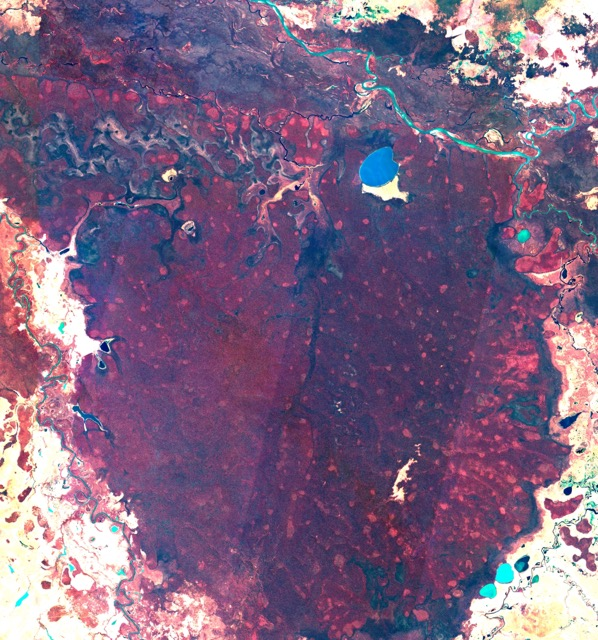
<figcaption aria-hidden="true">Sentinel-2 false color image composite of Itenez Forest Preserve from summer 2023. Light red spots indicate drier , lowcanopy vegetation associated with anthropogenic forest gardens (palms, cacao, bamboo, and other economically useful plants).</figcaption>
</figure>

The detection of these features at regional scale required developing new methodological approaches that combine AI-assisted pattern recognition with expert archaeological interpretation—a partnership where computational tools support but do not replace human expertise in identifying and mapping cultural landscapes.

## Methods

### Image Selection and Processing

I selected Sentinel-2 imagery \[@copernicus_s2_sr_harmonized\] from the driest periods in the satellite record (late summer 2023 and 2024), when reduced vegetation moisture and seasonal leaf loss maximize visibility of underlying soil and vegetation patterns. Cloud-free mosaics were processed in Google Earth Engine, combined with a state of the art regional canopy height model \[@wagner2025highresolutiontreeheight\] to distinguish anthropogenic forest structures from natural variation.

In [ ]:
plot_nth_set_gg(triplets, 58)

The imagery was exported as multi-scale tiles (512, 768, and 1024 pixels) with band combinations optimized to highlight spectral signatures of ADE and modified forest. These signatures reflect the distinct ecological characteristics of anthropogenic landscapes: more open canopy structure, seasonal deciduousness, high concentrations of useful plants (palms, bamboos, cacao), and altered soil chemistry from centuries of human occupation and management \[@heckenberger2008, @palace2017, @robinson2021\].

<figure>
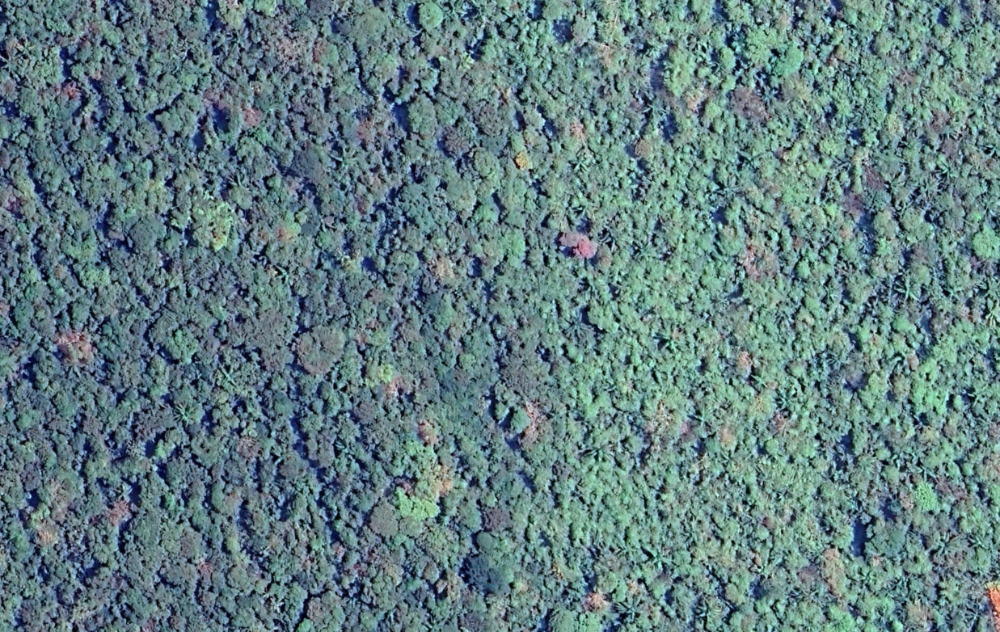
<figcaption aria-hidden="true">Detail of transition between natural forest vegetation (left) and anthropogenic forest (right). Not the lighter vegetation, lower canopy, and preponderance of palms and lianas.</figcaption>
</figure>

### Detection Workflow: Human-AI Partnership

I developed an agentic object detection system using GPT-4.1, and Moondream2 vision-language models to identify anthropogenic features at scale. This system serves as a detection and verification tool, supporting human expertise rather than replacing it. The workflow operates as follows:

1.  GPT models review imagery and generate initial hypotheses about feature locations based on spectral patterns and landscape context. They are prompted to view the landscape holistically, looking for patterns across multiple domains, rather than focusing on strict quantitative criteria.
2.  The primary models iteratively refine predictions through successive passes using a smaller, specialized vision language models tuned for object detection and grounding. These system lack the domain knowledge of the image contents, so the GPT agent must generate creative, abstract text prompts to detect all features in the scene (e.g. “reddish-pink spots”, “purple swirls”.
3.  The system produces point predictions marking potential anthropogenic sites
4.  These points guide large-scale verification and exploration of spatial patterns

**Examples:**

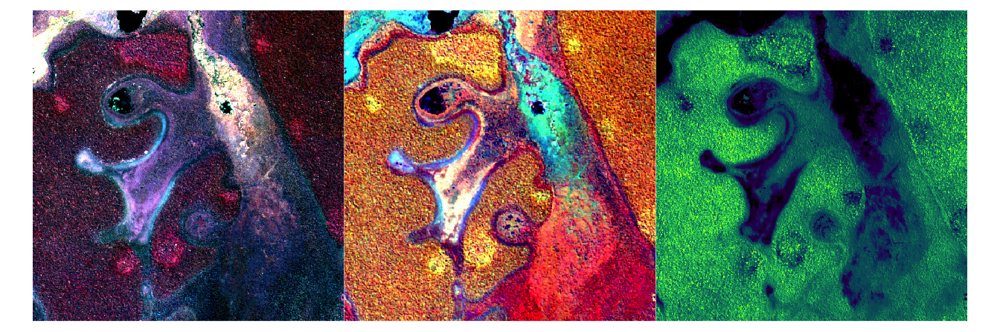

In [ ]:
plot_nth_set_gg(triplets, 59)

In [ ]:
agent_test1 <- detect_anthrosols(triplets[[59]], mode = 'gpt-4.1', echo = TRUE)

**Scene interpretation:**

- **C1:** The image shows a continuous forest matrix with a mottled texture. 
There are several compact, bright reddish-pink/magenta patches, especially in 
the lower left, lower center, and upper center-left. These are not simple 
forest/nonforest boundaries but are embedded within the forest. Some patches 
have a lobate or elliptical form, and a few are clustered. There are also faint
linear features (possible earthwork traces) connecting or bordering some 
patches.
- **C2:** The reddish-pink/magenta patches in C1 correspond to bright 
yellow/orange splotches in C2, supporting the interpretation of stressed/drier 
vegetation with low transpiration—consistent with ADE/terra preta patches.
- **CHM:** Several of these patches correspond to lower canopy height (darker 
blue/purple), sometimes as a patch or ring, further supporting the ADE 
hypothesis.

**Initial expert estimate:**  
There are at least 3–5 compact, plausible ADE-like anomalies in this scene, 
wi

◯ [tool call] tool_001(prompt = "reddish-pink spots")

● #> [{"x":0.0918,"y":0.2998},{"x":0.292,"y":0.8223},{"x":0.4375,"y":0.7656},{…

◯ [tool call] tool_001(prompt = "large magenta patch")

● #> [{"x":0.8486,"y":0.3789}]

◯ [tool call] tool_001(prompt = "lobate red blobs")

● #> [{"x":0.0918,"y":0.3037},{"x":0.2959,"y":0.8213},{"x":0.4365,"y":0.7666},…

**Synthesis of Moondream points:**

- The three prompts returned overlapping results, with strong agreement on the 
main compact reddish-pink/magenta patches.
- After removing redundant points (within a few pixels of each other), the 
following distinct patch centers are identified:
  1. (0.092, 0.300) — lower left, large lobate patch
  2. (0.292, 0.822) — lower center, compact patch
  3. (0.437, 0.766) — lower center-right, compact patch
  4. (0.631, 0.597) — mid-right, compact patch
  5. (0.734, 0.109) — upper right, compact patch
  6. (0.849, 0.379) — upper right, compact patch
  7. (0.968, 0.671) — far right edge, partial patch

- All selected points correspond to compact, ≥5 ha anomalies with dual spectral
support (C1: reddish-pink/magenta, C2: yellow/orange) and some with CHM support
(lower canopy).
- The spatial pattern is consistent with ADE/terra preta patches: compact, 
lobate, some clustered, some near possible earthwork traces.
- No points are simple forest/nonforest bounda

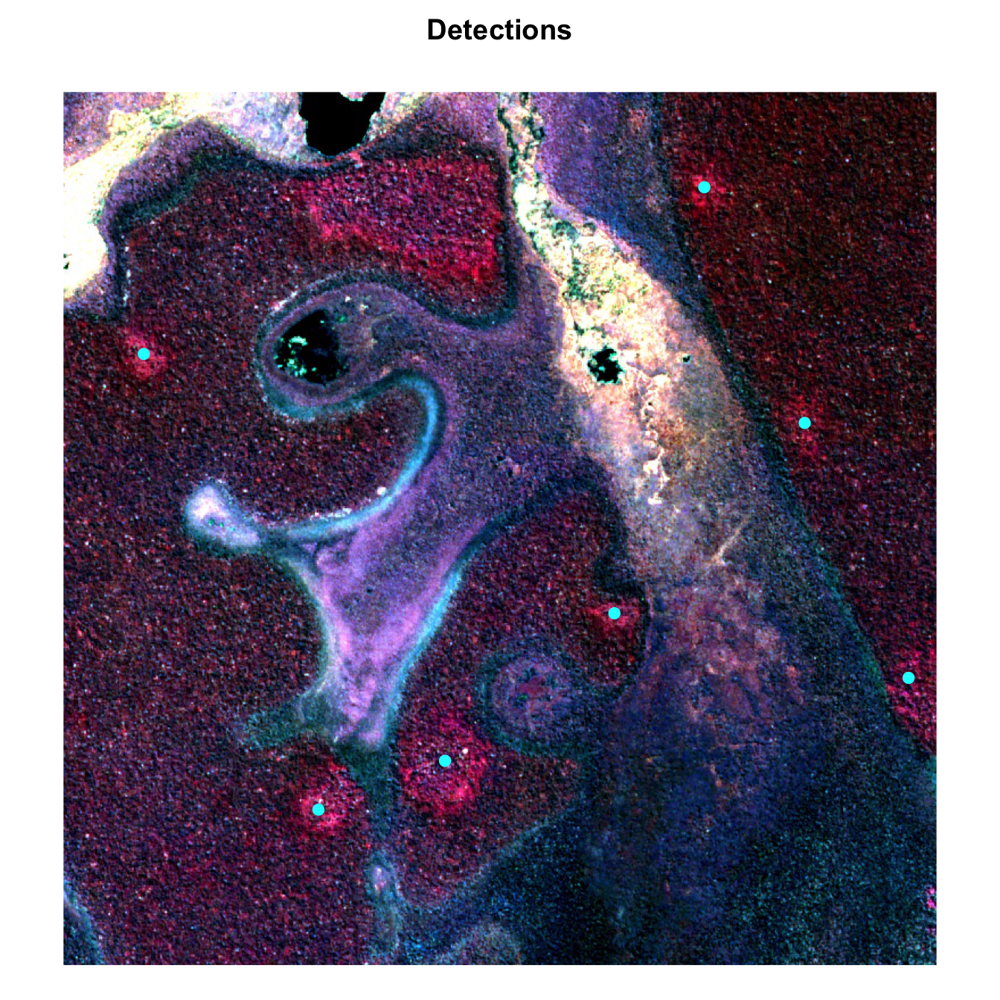

In [ ]:
plot_detections(agent_test1)

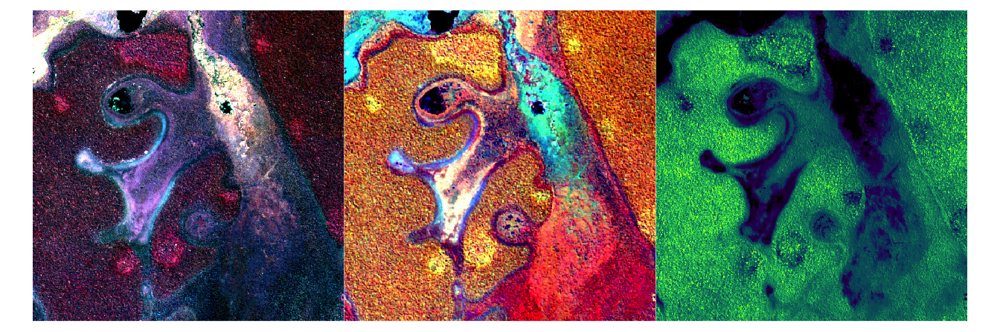

In [ ]:
plot_nth_set_gg(triplets, 59)

In [ ]:
agent_test2 <- detect_anthrosols(triplets[[58]], mode = 'gpt-4.1', echo = TRUE)

**Scene interpretation (Step 1):**

- **C1:** Several compact, lobate, reddish-pink/magenta patches are visible, 
especially to the right of the main drainage and near the center. These are 
embedded within a mottled forest matrix, not at the forest edge or in 
open/floodplain areas. The patches are not diffuse and have a compact form.
- **C2:** The same areas show supporting bright yellow/orange splotches, 
confirming low transpiration and stress consistent with ADE patches.
- **CHM:** Some of these patches correspond to subtle low-canopy anomalies 
(darker purple/blue), especially in the right-central and lower-central areas, 
supporting the interpretation.

**Spatial context:** The anomalies are aligned along the bluff edge and fractal
drainage, matching expected ADE/earthwork settlement patterning. No evidence of
recent sharp land-use mosaics or forest-nonforest boundaries.

**Initial expert estimate:** 3–5 valid ADE patch candidates, mainly in the 
right-central and lower-central 

◯ [tool call] tool_002(prompt = "reddish-pink spots")

● #> [{"x":0.7393,"y":0.6631},{"x":0.6777,"y":0.3467},{"x":0.8906,"y":0.3037},…

◯ [tool call] tool_002(prompt = "large magenta patch")

● #> [{"x":0.7344,"y":0.668}]

**Synthesis (Step 3):**

- The "reddish-pink spots" prompt returned 7 points; "large magenta patch" 
returned 1 point, which overlaps with one of the first set (0.7393, 0.6631 vs 
0.7344, 0.668).
- After removing redundancy, there are 7 unique points.
- Reviewing each:
  - Points at (0.7393, 0.6631), (0.6777, 0.3467), and (0.8906, 0.3037) are in 
the right-central and upper-right, matching compact, bright magenta/yellow 
anomalies with CHM support.
  - (0.3594, 0.5459) is a compact patch in the central area, also supported.
  - (0.0898, 0.5029) and (0.0898, 0.8389) are near the left edge; these are 
less clear but may represent edge patches consistent with the broader context.
  - (0.4238, 0.9707) is at the bottom edge; this is less certain but could be a
valid edge patch.
- All points are compact, have dual spectral support, and fit the expected 
context and form. No points are spurious or isolated blobs.

**Summary:** 7 distinct, valid ADE patch candidates detected.

DONE.

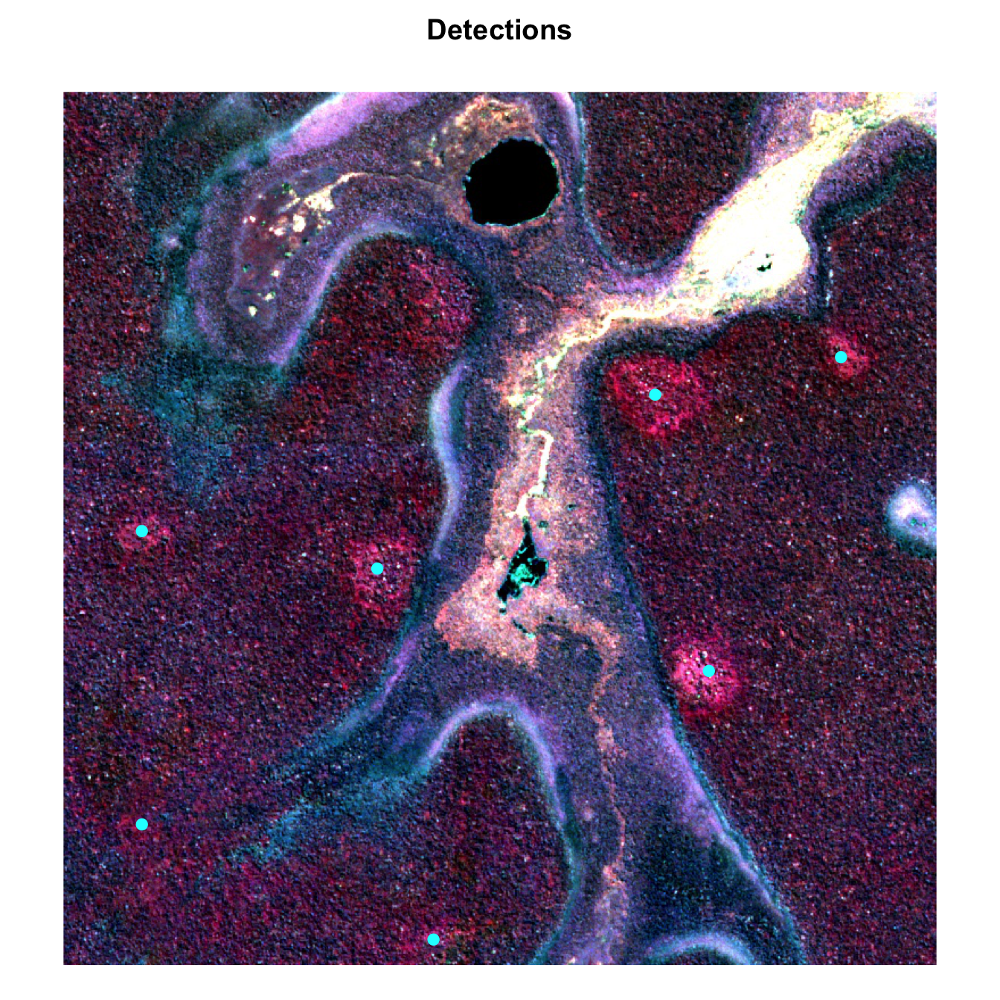

In [ ]:
plot_detections(agent_test2)

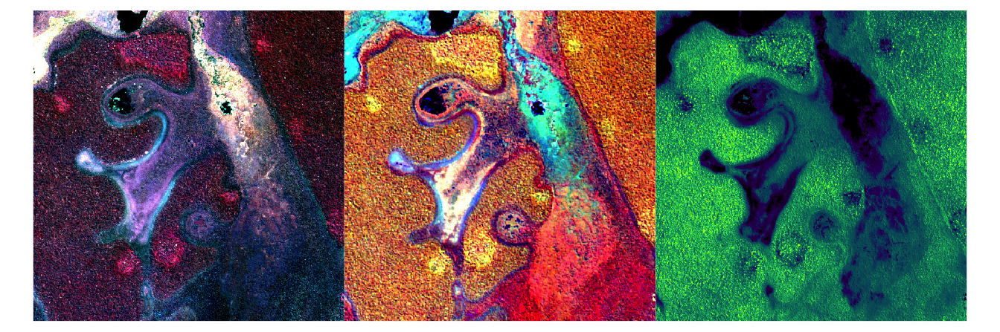

In [ ]:
plot_nth_set_gg(triplets, 59)

In [ ]:
agent_test3 <- detect_anthrosols(triplets[[50]], mode = 'gpt-4.1', echo = TRUE)

**Scene interpretation (Step 1):**

- **C1:** Several compact, lobate, reddish-pink/magenta patches are visible, 
especially in the lower center, lower right, and mid-left of the image. These 
patches are embedded within a continuous forest matrix, not at the forest edge 
or in floodplain.
- **C2:** These same areas correspond to bright yellow/orange splotches, 
supporting the interpretation of stressed/drier vegetation with low 
transpiration.
- **CHM:** The same patches show as slightly lower canopy (darker blue/purple) 
or as compact clusters, consistent with ADE/terra preta forest structure.
- **Form/Context:** Patches are compact, not diffuse, and are distributed in a 
pattern suggestive of anthropogenic origin (not random disturbance or natural 
forest islands). Some are loosely aligned along subtle drainage or earthwork 
traces.

**Initial expert estimate:** 7–10 valid ADE patch candidates, based on the 
number of distinct, compact, spectrally and structurally supported anomalie

◯ [tool call] tool_003(prompt = "reddish-pink spots")

● #> [{"x":0.4102,"y":0.6172},{"x":0.4121,"y":0.8291},{"x":0.5,"y":0.9248},{"x…

◯ [tool call] tool_003(prompt = "large magenta patches")

● #> [{"x":0.4102,"y":0.8301},{"x":0.4062,"y":0.6182},{"x":0.3193,"y":0.5068},…

**Synthesis of Moondream points:**

- Both prompts ("reddish-pink spots", "large magenta patches") returned 
overlapping but not identical sets of points.
- After removing redundant/overlapping points and filtering for compactness, 
dual spectral/structural support, and context, I identify **9 distinct ADE 
patch candidates**:
  - Lower center (cluster of 2)
  - Lower right (cluster of 3)
  - Mid-left (1)
  - Upper right (2)
  - Lower left/edge (1)
- All selected points are supported by both C1 (reddish/magenta) and C2 
(yellow/orange), and show compact form in CHM.
- Excluded: points at extreme image corners/edges with ambiguous context, and 
any that lacked clear dual spectral/structural support.

**Ready for final JSON output on your prompt.**

DONE

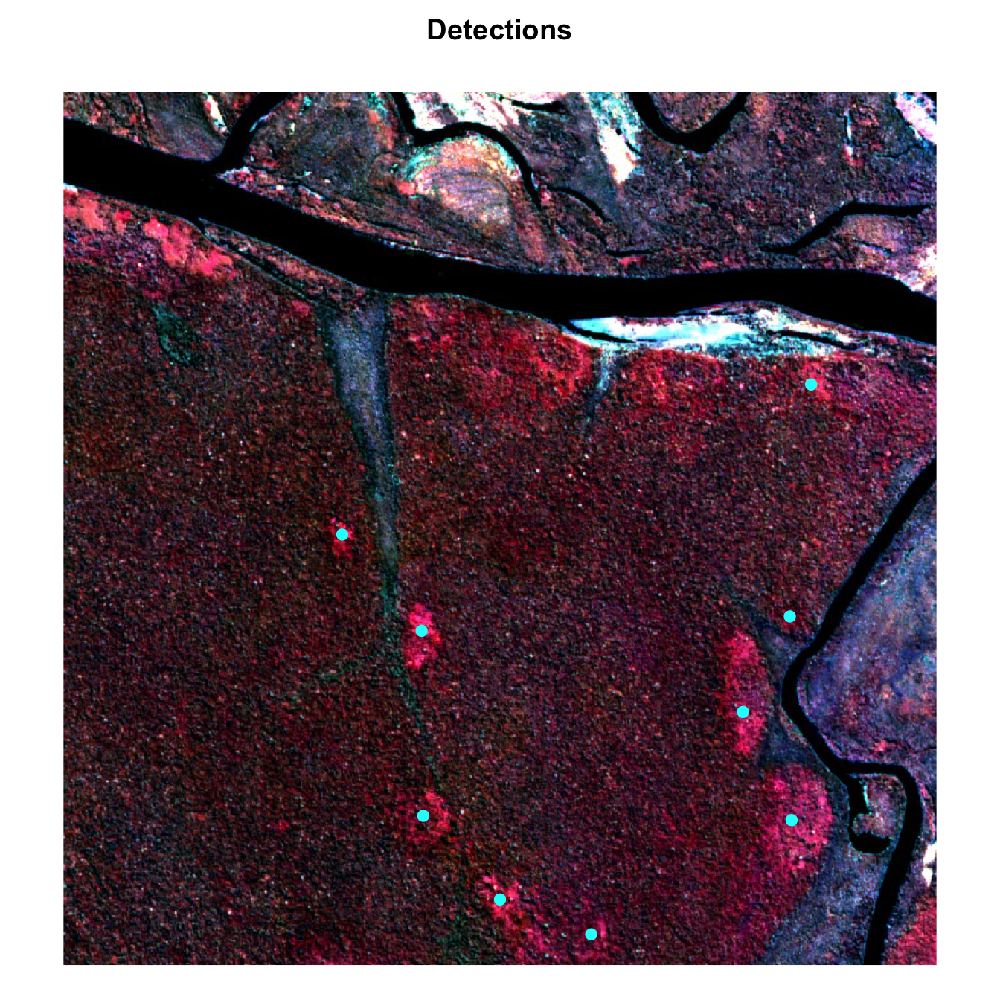

In [ ]:
plot_detections(agent_test3)

Critically, this AI component operated in parallel with detailed manual mapping. I meticulously reviewed and labeled hundreds of polygon boundaries over anthropogenic forest patches through careful imagery analysis, with the AI and manual mapping developing iteratively and informing each other. Earthworks—canals, ditches, and geometric earthworks—were recorded where visible through the canopy, though comprehensive mapping of these linear features remains a priority for future work with higher-resolution imagery. This approach allowed me to iteratively calibrate and validate the models’ ability to detect known archaeological features in zero-shot and few-shot learning contexts. The models were not fine-tuned but leveraged pre-trained capabilities to recognize visual patterns consistent with archaeological features. This approach exemplifies how AI can extend human capacity for regional-scale analysis without replacing the expertise necessary for accurate feature identification and interpretation.

## Results

The analysis **identified approximately 180 km² of anthropogenic soils and forest gardens within the Iténez Forest Preserve, representing 5% of its total area—comparable to the footprint of many modern world cities**, though distributed as a network of patches rather than a contiguous area. I mapped over 350 individual fields ranging from 5 to 700 hectares, with clear spatial clustering along bluffs, drainages, and floodplain margins in upland *terra firme* forest—confirming hypotheses about bluff-edge settlement systems previously proposed for this region \[@denevan1996\].

In [ ]:
anthrosols <- read_sf('data/derived/anthrosols.gpkg') |>
    mutate(area = units::set_units(st_area(geom), km2) |> units::drop_units())

mapview(anthrosols, basemaps = 'Esri.WorldImagery')

<SpatRaster> resampled to 500778 cells.

In [ ]:
convert_tile_points <- function(points_tibble, tile_geom) {
  # Get bounding box of the tile
  bbox <- st_bbox(tile_geom)
  # Convert normalized coordinates to spatial coordinates
  points_tibble %>%
    mutate(
      spatial_x = bbox["xmin"] + x * (bbox["xmax"] - bbox["xmin"]),
      spatial_y = bbox["ymin"] + y * (bbox["ymax"] - bbox["ymin"])
    )
}

combine_all_points <- function(points_list, tiles_list) {
  # Convert all and add tile index
  spatial_list <- map2(points_list, tiles_list, convert_tile_points) %>%
    imap(~ mutate(.x, tile_id = .y))  # Add tile identifier
  
  # Combine all tibbles
  all_points <- bind_rows(spatial_list)
  
  # Convert to sf using CRS from first tile
  all_points %>%
    st_as_sf(coords = c("spatial_x", "spatial_y"), 
             crs =4326)
}

agent_results <- readRDS(here('data/derived/moon_41.rds'))

agent_points <- map(agent_results, ~.x$result$points) |>
  combine_all_points(tiles$geom) |>
  select(-x, -y)

ggplot() +
  geom_spatraster_rgb(data = elev_tiles) +  # basemap
  geom_sf(data = st_centroid(anthrosols),fill = 'black') +
  geom_sf(data = agent_points, size = 1, color = 'red') +
  coord_sf(crs = st_crs(elev_tiles)) +
  theme_void()

<SpatRaster> resampled to 500778 cells.

The most striking discovery is a major complex spanning more than 4 kilometers, where large-scale fields connect through networks of earthworks. Across the mapped area, an exceptionally dense system of linear features links settlements into an integrated landscape. While full mapping of these earthworks awaits future work with canopy-penetrating sensors, their visible portions already demonstrate a level of landscape integration comparable to the most complex sites in neighboring regions.

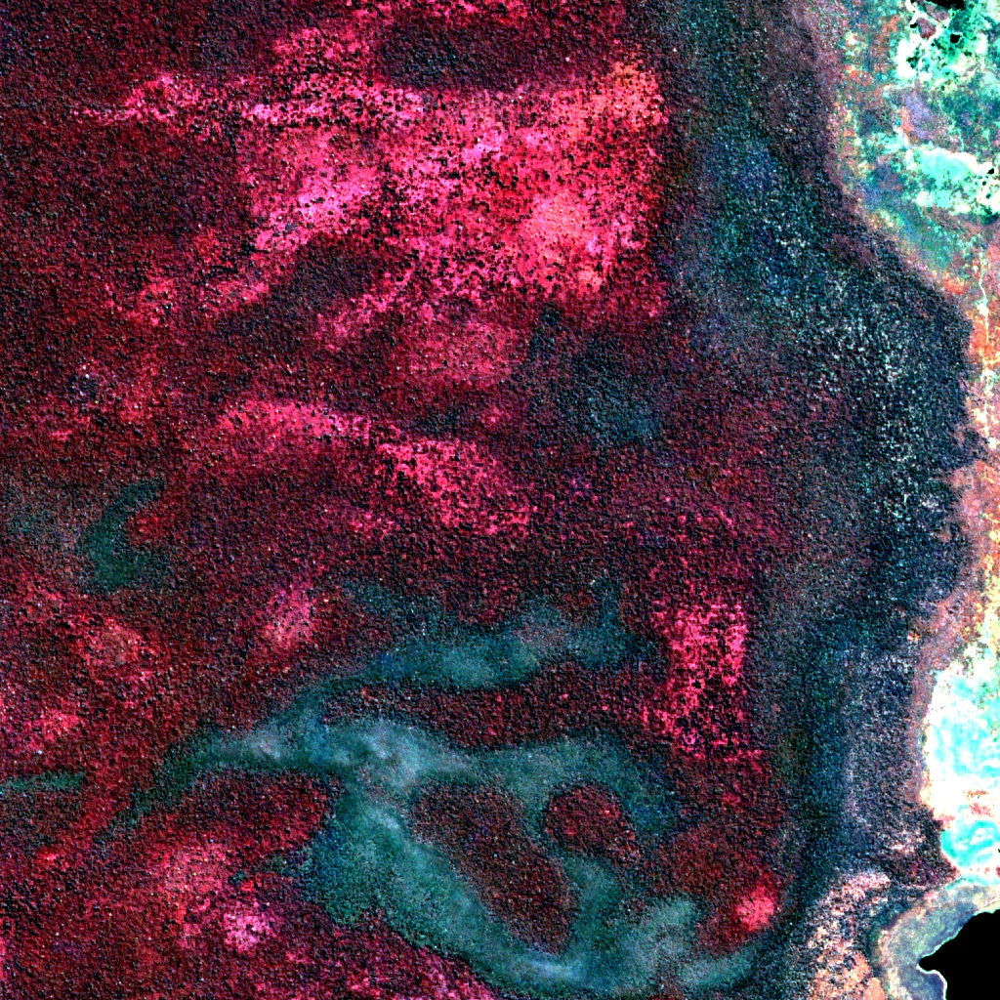

Rank-size analysis reveals a clear hierarchical structure in field sizes and site distribution, with the size distribution following a power law with an exponent close to 1 on log-log plots. This pattern, consistent with organized settlement systems, matches the scale and complexity documented in the Llanos de Mojos and Baures \[@prumers2022lidar; @erickson2000\]. The largest sites anchor networks of settlement and agroforestry patches, suggesting centralized planning and resource management across the landscape.

`geom_smooth()` using formula = 'y ~ x'

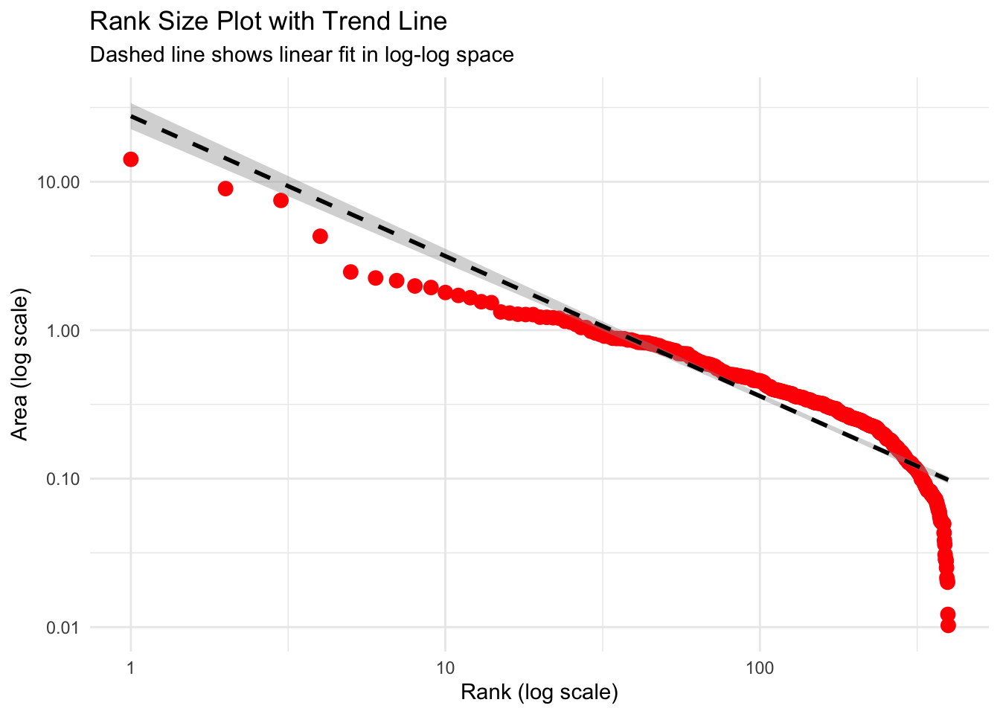

In [ ]:
# Prepare data for rank size plot
rank_size_data <- anthrosols %>%
  arrange(desc(area)) %>%
  mutate(rank = row_number())

# Add trend line to check for Zipf's law
ggplot(rank_size_data, aes(x = rank, y = area)) +
  geom_point(size = 3, color = "red") +
  geom_smooth(method = "lm", se = TRUE, color = "black", linetype = "dashed") +
  scale_x_log10() +
  scale_y_log10() +
  labs(title = "Rank Size Plot with Trend Line",
       x = "Rank (log scale)",
       y = "Area (log scale)",
       subtitle = "Dashed line shows linear fit in log-log space") +
  theme_minimal()

These anthropogenic landscapes remain ecologically distinct today. Forest composition in mapped areas shows high concentrations of economically useful species, particularly cacao, making the region a modern hotspot for wild cacao cultivation—a direct legacy of ancient land use practices \[@carson2016pre\] . Local and Indigenous communities continue to harvest these resources, underscoring that these are not merely archaeological sites but living landscapes where ancient management practices continue to shape both forest ecology and human livelihoods.

## Discussion

These findings transform our understanding of the Iténez region from archaeological blank spot to critical piece in the Amazonian puzzle. The extent and organization of anthropogenic landscapes documented here match or exceed those in better-studied areas, confirming that large-scale landscape engineering extended continuously across the southwestern Amazon. This fills the last major gap in the regional archaeological map between the Llanos de Mojos and Baures, revealing that the Iténez was not a periphery but an integral part of pre-Columbian regional systems.

The hierarchical site structure and extensive earthwork networks point to complex social organization capable of coordinating landscape modification across thousands of square kilometers. Rather than isolated communities practicing small-scale agriculture, the evidence suggests integrated regional systems linking settlements through engineered infrastructure and shared land management practices. The concentration of sites along bluff edges and floodplain margins confirms earlier hypotheses about settlement preferences in *terra firme* forests, while the scale revealed here exceeds previous expectations.

The ecological legacy of these ancient landscapes extends beyond their archaeological significance. Forest composition in mapped areas reflects centuries of human selection for useful species, creating patches of anthropogenic forest that blur the line between nature and culture. The continued harvesting of cacao and other products from these forests by contemporary communities represents an unbroken tradition of forest management extending from pre-Columbian times to the present. This continuity challenges us to recognize that the “pristine” forests we seek to conserve are themselves products of Indigenous innovation and management.

The successful detection of these features through combined AI and expert analysis demonstrates new possibilities for archaeological survey in forested regions. The human-AI partnership developed here—where computational tools assist in pattern detection while human expertise guides interpretation and mapping—offers a model for scaling archaeological survey across Amazonia’s vast forests. This approach proved particularly effective for identifying the subtle spectral signatures of anthropogenic soils and forest gardens that would be impossible to map at this scale through ground survey alone.

### Implications and Future Directions

This work contributes to the mounting evidence that the Amazon was extensively shaped by its pre-Columbian inhabitants, adding a major piece to our understanding of regional cultural landscapes. The Iténez landscapes join the growing inventory documented by recent synthetic works, while demonstrating that significant discoveries remain to be made even in the 21st century. The findings reinforce emerging models of pre-Columbian Amazonia as a mosaic of engineered landscapes rather than pristine wilderness punctuated by occasional cultural sites.

Future research should pursue several directions. First, LiDAR or high-resolution radar imagery could reveal the full extent of earthwork networks currently hidden beneath the canopy, allowing comprehensive mapping of the linear features only partially visible in optical imagery. Second, systematic field verification and dating would establish the chronology and cultural affiliations of these landscapes, potentially revealing connections to known archaeological cultures of the Llanos de Mojos and Baures. Third, detailed ecological studies of forest composition and soil properties would deepen our understanding of how ancient management practices created the anthropogenic forests that communities value today. The methodological approach developed here—combining AI-assisted detection with expert archaeological interpretation—offers broader applications for Amazonian archaeology. As we refine these tools, maintaining the balance between computational efficiency and human expertise will be critical. AI can help us see patterns across vast scales, but understanding what those patterns mean for human history requires archaeological knowledge that no algorithm can replace.

These findings also have immediate relevance for conservation planning. Protecting these forests means protecting both biodiversity and living Indigenous heritage—recognizing that the ecological richness we value today emerged from millennia of human management.

## Conclusion

The Iténez Forest Preserve emerges from this analysis not as pristine wilderness but as a cultural landscape shaped by centuries of Indigenous management. The 180 km² of mapped anthropogenic soils and forest gardens, connected by dense earthwork networks and organized in hierarchical patterns, demonstrate that pre-Columbian peoples transformed this region as extensively as anywhere in Amazonia. This work fills the last major blank spot in the archaeological map of the southwestern Amazon, revealing continuous cultural landscapes between previously studied regions.

These findings illustrate both the potential and limits of new technological approaches to archaeology. While AI-assisted detection enabled mapping at unprecedented scales, the interpretation and validation of these features required human expertise at every step. This partnership between computational tools and archaeological knowledge offers a path forward for understanding Amazonia’s human past across its vast forested expanses.

As we continue to reveal the Amazon’s deep human history, we gain essential perspective on its present and future. The forest gardens where communities harvest cacao today are living monuments to Indigenous landscape management, reminding us that the biodiversity we value emerged from millennia of human-forest interaction. Understanding this legacy is crucial not only for archaeology but for contemporary efforts to conserve and sustainably manage these cultural landscapes.

## Appendix

Comparison of tile-level site counts from observed data and zero-shot results from a variety of GPT models.

ℹ In argument: `centroids = lengths(st_intersects(geometry,
  st_centroid(anthrosols)))`.
Caused by warning:
! st_centroid assumes attributes are constant over geometries

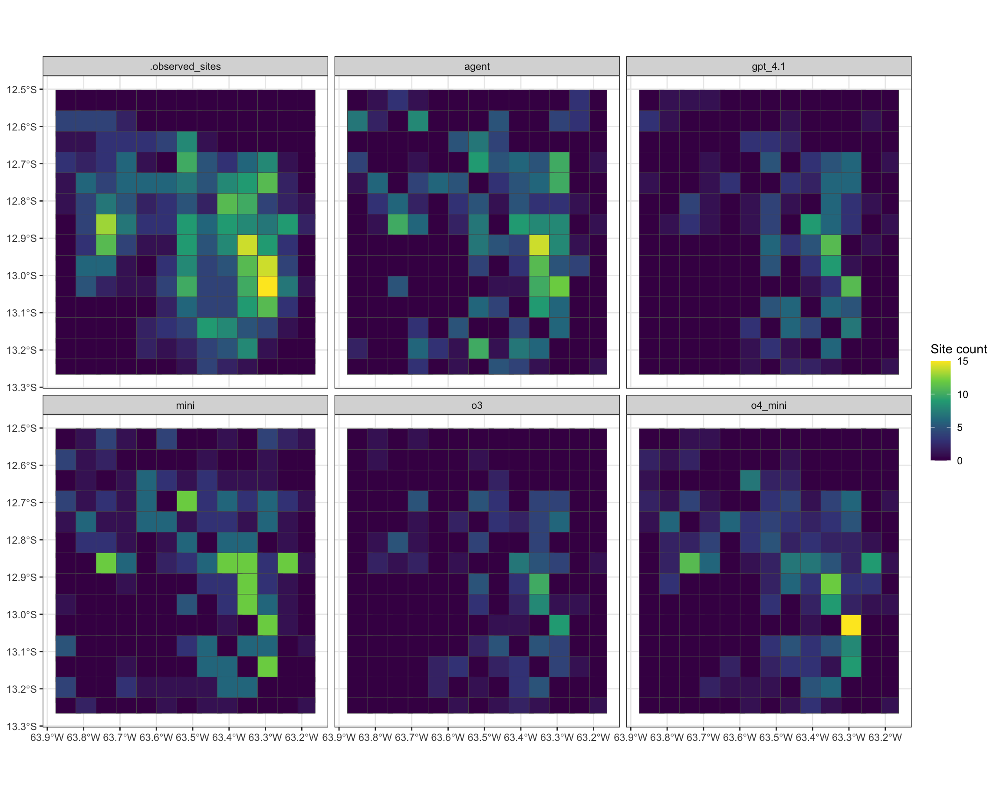

In [ ]:
results <- readRDS(here('data/derived/results.rds')) |>
  mutate(.truth = lengths(st_intersects(geometry, anthrosols)),
         centroids = lengths(st_intersects(geometry, st_centroid(anthrosols))),
         agent = map_dbl(agent_results, ~.x$result$count)
)

Performance metrics for zero-shot site detection:

In [ ]:
site_detection_metrics <- metric_set(accuracy, sens, spec, f_meas)

results |>
  select(-.truth) |>
  st_drop_geometry() |>
  pivot_longer(-c(id, centroids), names_to = 'model', values_to = 'estimate') |>
  group_by(model) |>
  mutate(estimate = factor(estimate > 0),
         truth = factor(centroids > 0)) |>
  site_detection_metrics(truth = truth, estimate = estimate, event_level = 'second') |>
  select(-.estimator) |>
  pivot_wider(names_from = .metric, values_from = .estimate) |>
  mutate(across(where(is.numeric), ~ round(.x, 3))) %>%
  arrange(desc(accuracy)) |>
  kableExtra::kable()

  model       accuracy    sens    spec   f_meas
  --------- ---------- ------- ------- --------
  o4_mini        0.742   0.672   0.873    0.773
  nano           0.681   0.950   0.175    0.796
  agent          0.670   0.613   0.778    0.709
  mini           0.654   0.664   0.635    0.715
  gpt_4.1        0.637   0.513   0.873    0.649
  o3             0.615   0.454   0.921    0.607


Performance metrics for zero-shot site counting:

In [ ]:
regression_metrics <- metric_set(rmse, mae, rsq)

results |>
  select(-.truth) |>
  st_drop_geometry() |>
  pivot_longer(-c(id, centroids), names_to = 'model', values_to = 'estimate') |>
  group_by(model) |>
  mutate(estimate = pmax(estimate, 1e-6)) |>
  regression_metrics(truth = centroids, estimate = estimate) |>
  select(-.estimator) |>
  pivot_wider(names_from = .metric, values_from = .estimate) |>
  mutate(across(where(is.numeric), ~ round(.x, 3))) %>%
  arrange(rmse) |>
  kableExtra::kable()

  model        rmse     mae     rsq
  --------- ------- ------- -------
  agent       2.910   1.852   0.460
  o4_mini     3.063   1.901   0.486
  mini        3.097   2.143   0.413
  gpt_4.1     3.331   2.170   0.458
  o3          3.637   2.379   0.404
  nano        3.813   2.703   0.072
